In [1]:
import pickle 
import numpy as np 
from matplotlib import pyplot as plt 
from scipy import stats
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd 
%matplotlib inline

## Load Data

In [2]:
mp3d_dump = "/home/junting/project_cvl/SceneGraphNav/data/model_dump/mp3d_model_dump.pkl"
SGFN_dump = "/home/junting/project_cvl/SceneGraphNav/data/model_dump/SGFN_model_dump.pkl"

with open(mp3d_dump, "rb") as f:
    mp3d_data = pickle.load(f)

with open(SGFN_dump, "rb") as f:
    SGFN_data = pickle.load(f)


In [15]:
print(mp3d_data[0].keys())
print(SGFN_data[0].keys())

dict_keys(['obj_points', 'descriptor', 'pred_obj_prob', 'pred_obj_confidence', 'pred_obj_label', 'edges', 'pred_rel_prob', 'pred_rel_confidence', 'pred_rel_label', 'scene_name'])
dict_keys(['idx', 'scan_id', 'obj_points', 'edge_indices', 'descriptor', 'pred_obj_cls', 'pred_rel_cls', 'obj_feature', 'rel_feature', 'gt_obj_cls', 'gt_rel_cls', 'confidence'])


In [4]:
# Each object has descriptor with shape (256,9)
# First aggregate info of 256 points, then analyze 
mp3d_points = np.moveaxis(np.concatenate([scene['obj_points'] for scene in mp3d_data], axis=0), 1, -1) # from (N,9,256) to (N,256,9)
SGFN_points = np.moveaxis(np.concatenate([scene['obj_points'] for scene in SGFN_data], axis=0), 1, -1)
mp3d_desc_list = [stats.describe(obj_points, axis=0) for obj_points in mp3d_points]
SGFN_desc_list = [stats.describe(obj_points, axis=0) for obj_points in SGFN_points]

In [5]:
SGFN_points[0].shape

(256, 9)

## Position distribution 

In [6]:
mp3d_pos = np.array([desc.mean[:3] for desc in mp3d_desc_list])
SGFN_pos = np.array([desc.mean[:3] for desc in SGFN_desc_list])

In [26]:
mp3d_pos[:5, :]

array([[-9.3132257e-10, -4.6566129e-10,  0.0000000e+00],
       [ 3.7252903e-09, -1.8626451e-09,  6.9849193e-10],
       [ 1.8626451e-09,  1.8626451e-09,  0.0000000e+00],
       [-1.8626451e-09, -2.7939677e-09,  0.0000000e+00],
       [ 9.3132257e-10, -1.2805685e-09, -9.3132257e-10]], dtype=float32)

In [38]:
# # Plot distribution of positions 
# pos = np.concatenate((mp3d_pos, SGFN_pos), axis=0)
# pos_dataset = ["mp3d"] * mp3d_pos.shape[0] + ["SGFN"] * SGFN_pos.shape[0]
# pos_df = pd.DataFrame({'pos_x':pos[:,0], 'pos_y': pos[:,1], 'pos_z':pos[:,2], 'dataset':pos_dataset})
# fig = px.scatter_3d(pos_df, x='pos_x', y='pos_y', z='pos_z', color='dataset', size_max=1)
# fig.show()

### Notation: 
sampled object point clouds positions (256, 3) has **zero mean** 

In [34]:
########################### Meaningless visualization ##########################
# plot positions with dim-wise histogram
# # visualize position distribution by x y z axes separately 

# fig = make_subplots(rows=3, cols=1, subplot_titles=("X-axis", "Y-axis", "Z-axis"))

# fig.append_trace(
#     go.Histogram(x=mp3d_pos[:,0], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red"), 
#     row=1, col=1
# )
# fig.append_trace(
#     go.Histogram(x=SGFN_pos[:,0], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue"), 
#     row=1, col=1
# )
# fig.append_trace(
#     go.Histogram(x=mp3d_pos[:,1], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red"), 
#     row=2, col=1
# )
# fig.append_trace(
#     go.Histogram(x=SGFN_pos[:,1], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue"), 
#     row=2, col=1
# )
# fig.append_trace(
#     go.Histogram(x=mp3d_pos[:,2], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red"), 
#     row=3, col=1
# )
# fig.append_trace(
#     go.Histogram(x=SGFN_pos[:,2], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue"), 
#     row=3, col=1
# )

# # Reduce opacity to see both histograms
# # fig.update_traces(opacity=0.75)
# fig.show()

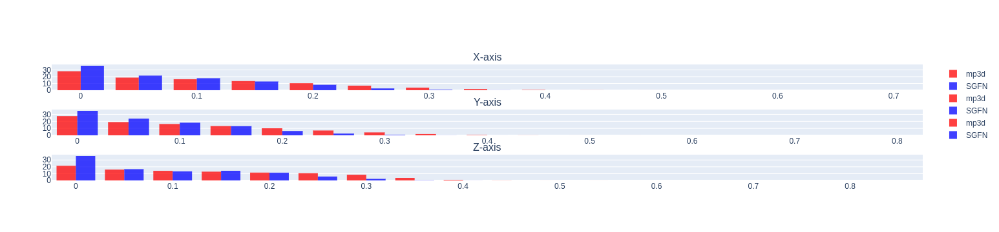

In [37]:
# plot position variance with dim-wise histogram
# visualize position distribution by x y z axes separately 
mp3d_pos_var = np.array([desc.variance[:3] for desc in mp3d_desc_list])
SGFN_pos_var = np.array([desc.variance[:3] for desc in SGFN_desc_list])
nbinsx=20


fig = make_subplots(rows=3, cols=1, subplot_titles=("X-axis", "Y-axis", "Z-axis"))

fig.append_trace(
    go.Histogram(x=mp3d_pos_var[:,0], opacity=0.75, name = 'mp3d', marker_color="red", histnorm='percent', nbinsx=nbinsx), 
    row=1, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_pos_var[:,0], opacity=0.75, name = 'SGFN', marker_color="blue", histnorm='percent', nbinsx=nbinsx), 
    row=1, col=1
)
fig.append_trace(
    go.Histogram(x=mp3d_pos_var[:,1], opacity=0.75, name = 'mp3d', marker_color="red", histnorm='percent', nbinsx=nbinsx), 
    row=2, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_pos_var[:,1], opacity=0.75, name = 'SGFN', marker_color="blue", histnorm='percent', nbinsx=nbinsx), 
    row=2, col=1
)
fig.append_trace(
    go.Histogram(x=mp3d_pos_var[:,2], opacity=0.75, name = 'mp3d', marker_color="red", histnorm='percent', nbinsx=nbinsx), 
    row=3, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_pos_var[:,2], opacity=0.75, name = 'SGFN', marker_color="blue", histnorm='percent', nbinsx=nbinsx), 
    row=3, col=1
)

# Reduce opacity to see both histograms
# fig.update_traces(opacity=0.75)
fig.show()

## Points density 

In [44]:
from tqdm import tqdm 
from scipy.spatial import ConvexHull
from scipy.spatial.distance import pdist, squareform

In [54]:
## Note: scipy ConvexHull tooooo slow!

# mp3d_dens_surf = []
# mp3d_dens_vol = []
# for obj_points in tqdm(mp3d_points):
#     hull = ConvexHull(obj_points)
#     mp3d_dens_surf.append(obj_points.shape[0]/hull.area)
#     mp3d_dens_vol.append(obj_points.shape[0]/hull.volume)

# Use min neighbor distance instead
mp3d_min_dist = []
for obj_points in tqdm(mp3d_points):
    dist_v = pdist(obj_points)
    dist_m = squareform(dist_v)
    np.fill_diagonal(dist_m, float('inf'))
    mp3d_min_dist.append(np.min(dist_m, axis=0))
mp3d_min_dist = np.concatenate(mp3d_min_dist, axis=0)

100%|███████████████████████████████████| 52446/52446 [00:19<00:00, 2623.01it/s]


In [56]:
SGFN_min_dist = []
for obj_points in tqdm(SGFN_points):
    dist_v = pdist(obj_points)
    dist_m = squareform(dist_v)
    np.fill_diagonal(dist_m, float('inf'))
    SGFN_min_dist.append(np.min(dist_m, axis=0))
SGFN_min_dist = np.concatenate(SGFN_min_dist, axis=0)

100%|█████████████████████████████████████| 3687/3687 [00:01<00:00, 2655.98it/s]


In [63]:
mp3d_min_dist.shape

(13426176,)

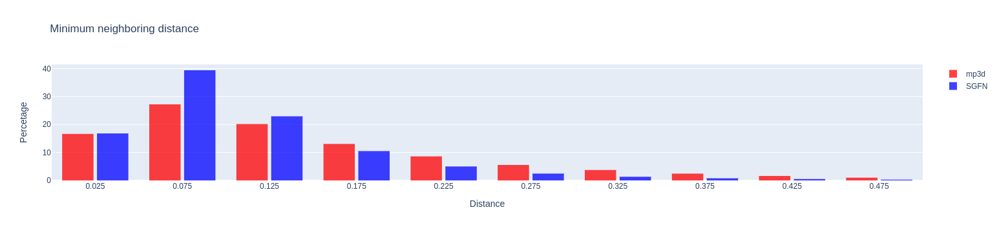

In [ ]:
# plot minimum distance with histogram
# hint for point clouds density
nbinsx=20
seed = 0
sample_n = 100000
np.random.seed(seed)
# mp3d_min_dist too large (13426176,)
mp3d_min_dist_sampled = np.random.choice(mp3d_min_dist, sample_n)
SGFN_min_dist_sampled = np.random.choice(SGFN_min_dist, sample_n)
fig = go.Figure()
fig.add_trace(go.Histogram(x=mp3d_min_dist_sampled, opacity=0.75, name = 'mp3d', marker_color="red", histnorm='percent',     
   xbins=dict( # bins used for histogram
        start=0.0,
        end=0.5,
        size=0.05
    )))
fig.add_trace(go.Histogram(x=SGFN_min_dist_sampled, opacity=0.75, name = 'SGFN', marker_color="blue", histnorm='percent',    
   xbins=dict( # bins used for histogram
        start=0.0,
        end=0.5,
        size=0.05
    )))
# Reduce opacity to see both histograms
fig.update_layout(
    title_text='Minimum neighboring distance', # title of plot
    xaxis_title_text='Distance', # xaxis label
    yaxis_title_text='Percetage', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.show()

## Color distribution 

In [7]:
mp3d_colors = np.array([desc.mean[3:6] for desc in mp3d_desc_list])
SGFN_colors = np.array([desc.mean[3:6] for desc in SGFN_desc_list])

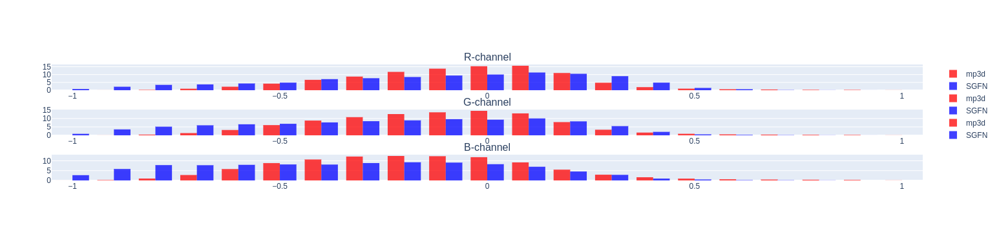

In [13]:
# plot colors with channel-wise histogram

fig = make_subplots(rows=3, cols=1, subplot_titles=("R-channel", "G-channel", "B-channel"))

fig.append_trace(
    go.Histogram(x=mp3d_colors[:,0], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red", nbinsx=nbinsx), 
    row=1, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_colors[:,0], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue", nbinsx=nbinsx), 
    row=1, col=1
)
fig.append_trace(
    go.Histogram(x=mp3d_colors[:,1], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red", nbinsx=nbinsx), 
    row=2, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_colors[:,1], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue", nbinsx=nbinsx), 
    row=2, col=1
)
fig.append_trace(
    go.Histogram(x=mp3d_colors[:,2], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red", nbinsx=nbinsx), 
    row=3, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_colors[:,2], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue", nbinsx=nbinsx), 
    row=3, col=1
)

# Reduce opacity to see both histograms
# fig.update_traces(opacity=0.75)
fig.show()

## Surface normals distribution

In [75]:
mp3d_normals_var = np.array([desc.variance[6:9] for desc in mp3d_desc_list])
SGFN_normals_var = np.array([desc.variance[6:9] for desc in SGFN_desc_list])

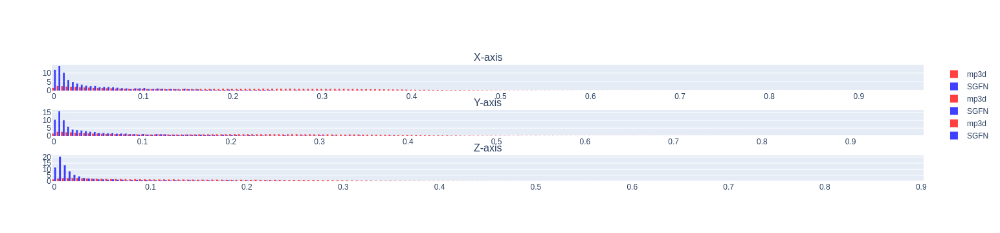

In [76]:
# # plot vertex normals variance with axis-wise histogram

fig = make_subplots(rows=3, cols=1, subplot_titles=("X-axis", "Y-axis", "Z-axis"))

fig.append_trace(
    go.Histogram(x=mp3d_normals_var[:,0], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red"), 
    row=1, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_normals_var[:,0], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue"), 
    row=1, col=1
)
fig.append_trace(
    go.Histogram(x=mp3d_normals_var[:,1], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red"), 
    row=2, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_normals_var[:,1], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue"), 
    row=2, col=1
)
fig.append_trace(
    go.Histogram(x=mp3d_normals_var[:,2], opacity=0.75, name='mp3d', histnorm='percent', marker_color="red"), 
    row=3, col=1
)
fig.append_trace(
    go.Histogram(x=SGFN_normals_var[:,2], opacity=0.75, name='SGFN', histnorm='percent', marker_color="blue"), 
    row=3, col=1
)

# Reduce opacity to see both histograms
# fig.update_traces(opacity=0.75)
fig.show()

In [10]:
# calculate surface normals vector norm
mp3d_sn_norm = np.linalg.norm(mp3d_points.reshape(-1,9), axis=1)
SGFN_sn_norm = np.linalg.norm(SGFN_points.reshape(-1,9), axis=1)

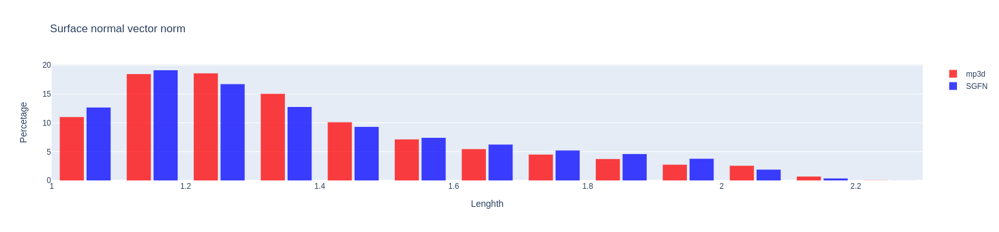

In [11]:
# plot surface normals vector norms with histogram
nbinsx=20
seed = 0
sample_n = 100000
np.random.seed(seed)
# mp3d_min_dist too large (13426176,)
mp3d_sn_norm_sampled = np.random.choice(mp3d_sn_norm, sample_n)
SGFN_sn_norm_sampled = np.random.choice(SGFN_sn_norm, sample_n)
fig = go.Figure()
fig.add_trace(go.Histogram(x=mp3d_sn_norm_sampled, opacity=0.75, name = 'mp3d', marker_color="red", histnorm='percent',     
   xbins=dict( # bins used for histogram
        start=1.0,
        end=3.0,
        size=0.1
    )))
fig.add_trace(go.Histogram(x=SGFN_sn_norm_sampled, opacity=0.75, name = 'SGFN', marker_color="blue", histnorm='percent',    
   xbins=dict( # bins used for histogram
        start=1.0,
        end=3.0,
        size=0.1
    )))
# Reduce opacity to see both histograms
fig.update_layout(
    title_text='Surface normal vector norm', # title of plot
    xaxis_title_text='Lenghth', # xaxis label
    yaxis_title_text='Percetage', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.show()

## Node features 

## Edge features

## Class label distribution 

## Relationship evaluation 

In [14]:
def read_house_file(house_file):
    house_format= \
    '''
        H name label num_images num_panoramas num_vertices num_surfaces num_segments num_objects num_categories num_regions num_portals num_levels  0 0 0 0 0  xlo ylo zlo xhi yhi zhi  0 0 0 0 0
        L level_index num_regions label  px py pz  xlo ylo zlo xhi yhi zhi  0 0 0 0 0
        R region_index level_index 0 0 label  px py pz  xlo ylo zlo xhi yhi zhi  height  0 0 0 0
        P portal_index region0_index region1_index label  xlo ylo zlo xhi yhi zhi  0 0 0 0
        S surface_index region_index 0 label px py pz  nx ny nz  xlo ylo zlo xhi yhi zhi  0 0 0 0 0
        V vertex_index surface_index label  px py pz  nx ny nz  0 0 0
        P name  panorama_index region_index 0  px py pz  0 0 0 0 0
        I image_index panorama_index  name camera_index yaw_index e00 e01 e02 e03 e10 e11 e12 e13 e20 e21 e22 e23 e30 e31 e32 e33  i00 i01 i02  i10 i11 i12 i20 i21 i22  width height  px py pz  0 0 0 0 0
        C category_index category_mapping_index category_mapping_name mpcat40_index mpcat40_name 0 0 0 0 0
        O object_index region_index category_index px py pz  a0x a0y a0z  a1x a1y a1z  r0 r1 r2 0 0 0 0 0 0 0 0 
        E segment_index object_index id area px py pz xlo ylo zlo xhi yhi zhi  0 0 0 0 0
    '''
    ############ parse house file format ########################3
    parse_dict = {}
    for line in house_format.splitlines():
        line = line.strip().split()
        if len(line) > 0:
            parse_dict[line[0]] = {}
            for shift in range(1,len(line)):
                if line[shift] != '0': # drop zero column
                    parse_dict[line[0]][line[shift]] = shift

        
    ########### parse house file with format dictionary ##############
    house_dict = {
        'H':[], # general house info 
        'L':[], # level
        'R':[], # region 
        'P':[], # portal
        'S':[], # triangle mesh surface
        'V':[], # vertex
        'P':[], # panorama image
        'I':[], # image
        'C':[], # category
        'O':[], # object
        'E':[]  # segment 
    }

    with open(house_file, "r") as f:
        next(f) # skip file encoding header 
        for line in f:
            line = line.split()
            if len(line) > 0:
                item_fmt = parse_dict[line[0]]
                item_dict = {item_property: line[item_fmt[item_property]] for item_property in item_fmt.keys()}
                house_dict[line[0]].append(item_dict)
                # if line[0] == 'R':
                #     region_fmt = parse_dict['R']
                #     region_dict = {item: line[region_fmt[item]] for item in region_fmt.keys()}
                #     house_dict['R'].append(region_dict)
                # elif line[0] == 'O':
                #     object_fmt = parse_dict['O']
                #     object_dict = {item: line[object_fmt[item]] for item in object_fmt.keys()}
                #     house_dict['O'].append(object_dict)
    
    return house_dict, parse_dict

In [16]:
print(mp3d_data[0].keys())

dict_keys(['obj_points', 'descriptor', 'pred_obj_prob', 'pred_obj_confidence', 'pred_obj_label', 'edges', 'pred_rel_prob', 'pred_rel_confidence', 'pred_rel_label', 'scene_name'])


In [ ]:
from tqdm import tqdm 
scan_dir = "/media/junting/SSD_data/habitat_data/scene_datasets/mp3d/v1/scans"

for scene_data in tqdm(mp3d_data):
    scene_dir = os.path.join(scan_dir, scene_data['scene_name'])
    house_file_path = os.path.join(scene_dir, f'{scene_data['scene_name']}.house')
    house_dict, meta_dict = read_house_file(house_file_path)
    object_dicts = {object_dict['object_index']: object_dict 
        for object_dict in house_dict['O']}
    
    for rel_
    center, sizes, r_mat = getOBB(object_dict)
    object_aabb = o3d.geometry.OrientedBoundingBox(center, r_mat, sizes)
    object_aabb.color = (1,0,1)
    o3d_vis_list.append(object_aabb)